In [1]:
import numpy as np
import tensorflow as tf
from keras import layers
from keras.layers import Input, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D
from keras.models import Model, load_model
from keras.preprocessing import image
from keras.utils import layer_utils
from keras.utils.data_utils import get_file
from keras.applications.imagenet_utils import preprocess_input
import pydot
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from keras.utils import plot_model
from keras.initializers import glorot_uniform
import scipy.misc
from matplotlib.pyplot import imshow
%matplotlib inline

import keras.backend as K
K.set_image_data_format('channels_last')
K.set_learning_phase(1)

/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:523: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:524: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:525: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passi

In [3]:
def identity_block(X, f, filters, stage, block):
    
    # Defining name basis
    conv_name_base = 'res' + str(stage) + block + '_branch'
    bn_name_base = 'bn' + str(stage) + block + '_branch'
    
    # Retrieve Filters
    F1, F2, F3 = filters
    
    # Save the input value
    X_shortcut = X
    
    # First component of main path
    X = Conv2D(filters = F1, kernel_size = (1, 1), strides = (1,1), padding = 'valid', name = conv_name_base + '2a', kernel_initializer = glorot_uniform(seed=0))(X)
    X = BatchNormalization(axis = 3, name = bn_name_base + '2a')(X)
    X = Activation('relu')(X)
    
    # Second component of main path
    X = Conv2D(filters = F2, kernel_size = (f, f), strides = (1, 1), padding = 'same', name = conv_name_base + '2b', kernel_initializer = glorot_uniform(seed=0))(X)
    X = BatchNormalization(axis = 3, name = bn_name_base + '2b')(X)
    X = Activation('relu')(X)

    # Third component of main path 
    X = Conv2D(filters = F3, kernel_size = (1, 1), strides = (1, 1), padding = 'valid', name = conv_name_base + '2c', kernel_initializer = glorot_uniform(seed=0))(X)
    X = BatchNormalization(axis = 3, name = bn_name_base + '2c')(X)

    # Final step: Add shortcut value to main path, and pass it through a RELU activation
    X = Add()([X, X_shortcut])
    X = Activation('relu')(X)
    
    return X

In [4]:
def convolutional_block(X, f, filters, stage, block, s=2):

    # Defining name basis
    conv_name_base = 'res' + str(stage) + block + '_branch'
    bn_name_base = 'bn' + str(stage) + block + '_branch'

    # Retrieve Filters
    F1, F2, F3 = filters

    # Save the input value
    X_shortcut = X

    ##### MAIN PATH #####
    # First component of main path 
    X = Conv2D(filters=F1, kernel_size=(1, 1), strides=(s, s), padding='valid', name=conv_name_base + '2a', kernel_initializer=glorot_uniform(seed=0))(X)
    X = BatchNormalization(axis=3, name=bn_name_base + '2a')(X)
    X = Activation('relu')(X)

    # Second component of main path
    X = Conv2D(filters=F2, kernel_size=(f, f), strides=(1, 1), padding='same', name=conv_name_base + '2b', kernel_initializer=glorot_uniform(seed=0))(X)
    X = BatchNormalization(axis=3, name=bn_name_base + '2b')(X)
    X = Activation('relu')(X)

    # Third component of main path
    X = Conv2D(filters=F3, kernel_size=(1, 1), strides=(1, 1), padding='valid', name=conv_name_base + '2c', kernel_initializer=glorot_uniform(seed=0))(X)
    X = BatchNormalization(axis=3, name=bn_name_base + '2c')(X)

    ##### SHORTCUT PATH #### 
    X_shortcut = Conv2D(filters=F3, kernel_size=(1, 1), strides=(s, s), padding='valid', name=conv_name_base + '1', kernel_initializer=glorot_uniform(seed=0))(X_shortcut)
    X_shortcut = BatchNormalization(axis=3, name=bn_name_base + '1')(X_shortcut)

    # Final step: Add shortcut value to main path, and pass it through a RELU activation
    X = Add()([X, X_shortcut])
    X = Activation('relu')(X)

    return X

In [5]:
def ResNet50(input_shape = (1024, 1024, 3), classes = 4):
    
    # Define the input as a tensor with shape input_shape
    X_input = Input(input_shape)

    
    # Zero-Padding
    X = ZeroPadding2D((3, 3))(X_input)
    
    # Stage 1
    X = Conv2D(64, (7, 7), strides = (2, 2), name = 'conv1', kernel_initializer = glorot_uniform(seed=0))(X)
    X = BatchNormalization(axis = 3, name = 'bn_conv1')(X)
    X = Activation('relu')(X)
    X = MaxPooling2D((3, 3), strides=(2, 2))(X)

    # Stage 2
    X = convolutional_block(X, f = 3, filters = [64, 64, 256], stage = 2, block='a', s = 1)
    X = identity_block(X, 3, [64, 64, 256], stage=2, block='b')
    X = identity_block(X, 3, [64, 64, 256], stage=2, block='c')

    # Stage 3
    X = convolutional_block(X, f=3, filters=[128, 128, 512], stage=3, block='a', s=2)
    X = identity_block(X, 3, [128, 128, 512], stage=3, block='b')
    X = identity_block(X, 3, [128, 128, 512], stage=3, block='c')
    X = identity_block(X, 3, [128, 128, 512], stage=3, block='d')

    # Stage 4
    X = convolutional_block(X, f=3, filters=[256, 256, 1024], stage=4, block='a', s=2)
    X = identity_block(X, 3, [256, 256, 1024], stage=4, block='b')
    X = identity_block(X, 3, [256, 256, 1024], stage=4, block='c')
    X = identity_block(X, 3, [256, 256, 1024], stage=4, block='d')
    X = identity_block(X, 3, [256, 256, 1024], stage=4, block='e')
    X = identity_block(X, 3, [256, 256, 1024], stage=4, block='f')
    
    # Stage 5
    X = convolutional_block(X, f=3, filters=[512, 512, 2048], stage=5, block='a', s=2)
    X = identity_block(X, 3, [512, 512, 2048], stage=5, block='b')
    X = identity_block(X, 3, [512, 512, 2048], stage=5, block='c')

    # AVGPOOL
    X = AveragePooling2D(pool_size=(2,2), padding='same')(X)

    # Output layer
    X = Flatten()(X)
    X = Dense(classes, activation='softmax', name='fc' + str(classes), kernel_initializer = glorot_uniform(seed=0))(X)
    
    
    # Create model
    model = Model(inputs = X_input, outputs = X, name='ResNet50')

    return model

In [6]:
model = ResNet50(input_shape = (1024, 1024, 3), classes = 4)

In [7]:
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [8]:
model.summary()

Model: "ResNet50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 1024, 1024, 3 0                                            
__________________________________________________________________________________________________
zero_padding2d_1 (ZeroPadding2D (None, 1030, 1030, 3 0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 512, 512, 64) 9472        zero_padding2d_1[0][0]           
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 512, 512, 64) 256         conv1[0][0]                      
___________________________________________________________________________________________

In [9]:
#confirm there is an attached GPU
K.tensorflow_backend._get_available_gpus()

['/job:localhost/replica:0/task:0/device:GPU:0',
 '/job:localhost/replica:0/task:0/device:GPU:1']

In [4]:
import os
import cv2
%matplotlib inline
from matplotlib import pyplot as plt

#load data
train_images_path = '/home/carolinemckee/split_train_clean/images/'
val_images_path = '/home/carolinemckee/split_val_clean_balanced/images/'
train_labels_path = '/home/carolinemckee/split_train_clean/labels/'
val_labels_path = '/home/carolinemckee/split_val_clean_balanced/labels/'

train_images_list = os.listdir(train_images_path) 
val_images_list = os.listdir(val_images_path)
print('Number of training images',len(train_images_list))
print('Number of validation images',len(val_images_list))

total_train = 0
for t_img in train_images_list:
    t_labels = train_labels_path + t_img[:-3] + 'txt'
    with open(t_labels,'r') as l_file:
        labels = [line.strip('\n') for line in l_file.readlines()]
        for i in range(0,len(labels),1000):
            total_train += 1
print('Total train labels:',total_train)

total_val = 0
for v_img in val_images_list:
    v_labels = val_labels_path + v_img[:-3] + 'txt'
    with open(v_labels,'r') as l_file:
        labels = [line.strip('\n') for line in l_file.readlines()]
        for i in range(0,len(labels),1000):
            total_val += 1
print('Total val labels:',total_val)

Number of training images 3134
Number of validation images 631
Total train labels: 3134
Total val labels: 631


In [5]:
train_imgs = np.zeros((total_train,1024,1024,3),dtype='uint8')
val_imgs = np.zeros((total_val,1024,1024,3),dtype='uint8')
train_labels = np.zeros((total_train,4),dtype='uint8')
val_labels = np.zeros((total_val,4),dtype='uint8')

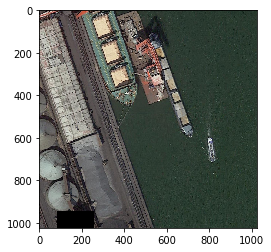

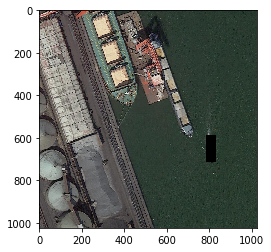

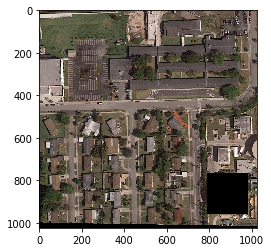

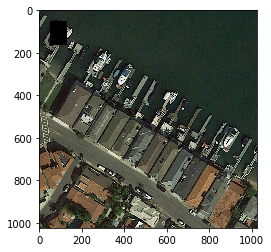

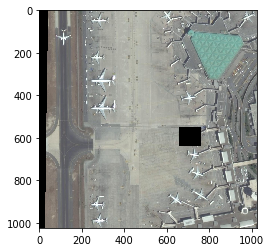

...

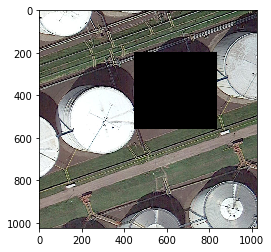

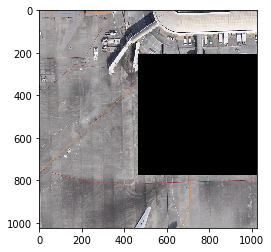

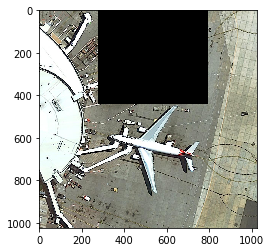

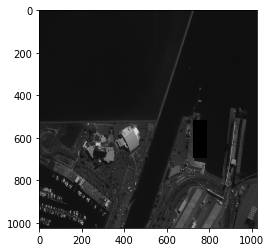

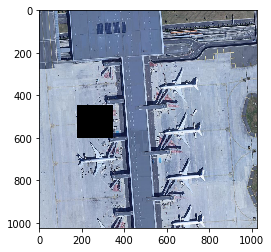

Added training image 500


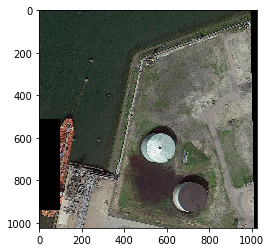

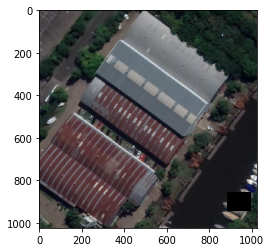

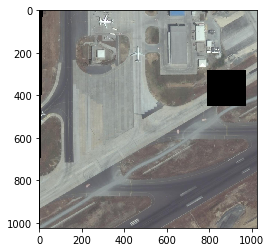

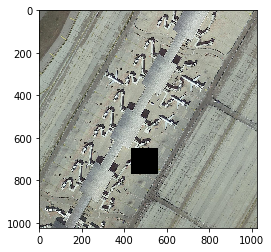

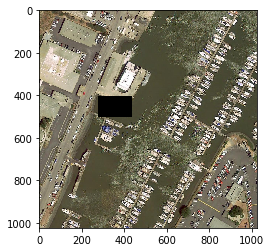

...

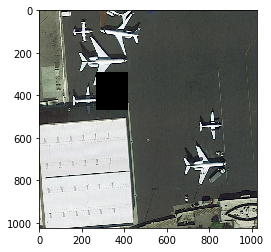

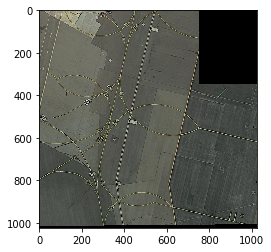

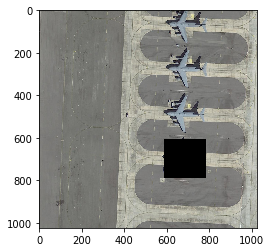

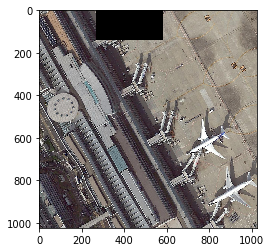

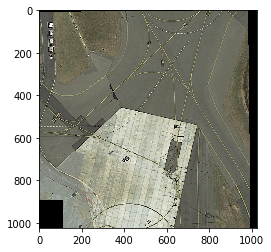

Added training image 1500


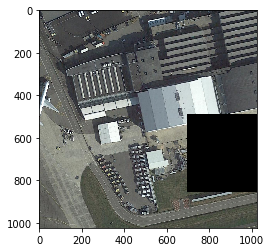

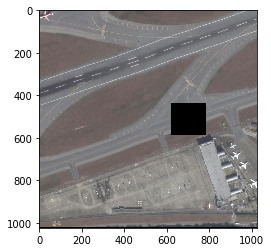

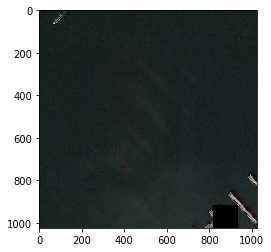

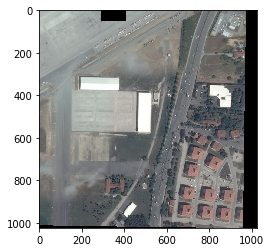

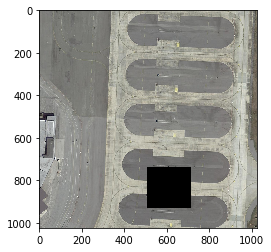

...

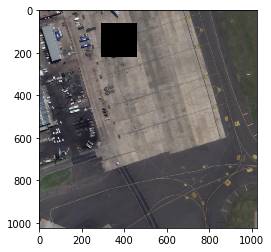

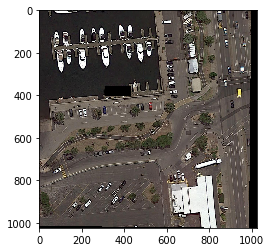

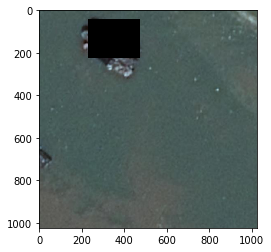

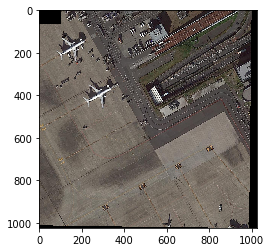

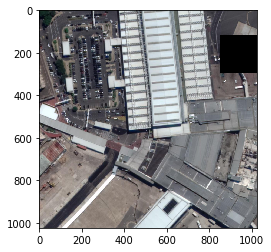

In [ ]:
skipped = 0
img_num = 0
for t_img in train_images_list:
    img = cv2.imread(train_images_path + t_img,cv2.IMREAD_COLOR)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    t_labels = train_labels_path + t_img[:-3] + 'txt'
    with open(t_labels,'r') as l_file:
        labels = [line.strip('\n') for line in l_file.readlines()]
        for i in range(0,len(labels),8):
            label = labels[i]
            label_list = label.split()
            for j in range(5):
                if j == 0:
                    label_list[j] = int(label_list[j])
                else:
                    label_list[j] = int(float(label_list[j])*1024)
            bb_img = np.copy(img)
            if bb_img.shape != (1024,1024,3):
                skipped += 1
                continue
            bb_img[int(label_list[2])-int(label_list[4]/2.0):int(label_list[2])+int(label_list[4]/2.0),int(label_list[1]) - int(label_list[3]/2.0):int(label_list[1]) + int(label_list[3]/2.0),:] = np.zeros((1,1,3))
            if label_list[3] > 100 or label_list[4] > 100:
                plt.imshow(bb_img)
                plt.show()
            train_imgs[img_num,:,:,:] = bb_img
            cl = label_list[0]
            one_hot = np.zeros((4,),dtype=int)
            one_hot[cl] = 1
            train_labels[img_num,:] = one_hot
            img_num += 1
    if img_num % 500 == 0:
        print('Added training image',img_num)

In [29]:
train_imgs = train_imgs[:-skipped]
train_labels = train_labels[:-skipped]
from sklearn.utils import shuffle
train_imgs, train_labels = shuffle(train_imgs, train_labels, random_state=0)

In [30]:
skipped = 0
img_num = 0
for v_img in val_images_list:
    img = cv2.imread(val_images_path + v_img,cv2.IMREAD_COLOR)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    v_labels = val_labels_path + v_img[:-3] + 'txt'
    with open(v_labels,'r') as l_file:
        labels = [line.strip('\n') for line in l_file.readlines()]
        for i in range(0,len(labels),8):
            label = labels[i]
            label_list = label.split()
            for j in range(5):
                if j == 0:
                    label_list[j] = int(label_list[j])
                else:
                    label_list[j] = int(float(label_list[j])*1024)
            bb_img = np.copy(img)
            if bb_img.shape != (1024,1024,3):
                skipped += 1
                continue
            bb_img[int(label_list[2])-int(label_list[4]/2.0):int(label_list[2])+int(label_list[4]/2.0),int(label_list[1]) - int(label_list[3]/2.0):int(label_list[1]) + int(label_list[3]/2.0),:] = np.zeros((1,1,3))
            val_imgs[img_num,:,:,:] = bb_img
            cl = label_list[0]
            one_hot = np.zeros((4,),dtype=int)
            one_hot[cl] = 1
            val_labels[img_num,:] = one_hot
            img_num += 1
    print('Added validation image',img_num)

Added validation image 22
Added validation image 23
Added validation image 26
Added validation image 27
Added validation image 31
Added validation image 38
Added validation image 84
Added validation image 87
Added validation image 91
Added validation image 92
Added validation image 94
Added validation image 97
Added validation image 99
Added validation image 100
Added validation image 101
Added validation image 104
Added validation image 106
Added validation image 118
Added validation image 119
Added validation image 120
Added validation image 121
Added validation image 122
Added validation image 123
Added validation image 124
Added validation image 125
Added validation image 126
Added validation image 129
Added validation image 131
Added validation image 132
Added validation image 133
Added validation image 135
Added validation image 136
Added validation image 137
Added validation image 138
Added validation image 139
Added validation image 140
Added validation image 141
Added validati

Added validation image 775
Added validation image 776
Added validation image 777
Added validation image 778
Added validation image 779
Added validation image 780
Added validation image 782
Added validation image 783
Added validation image 784
Added validation image 785
Added validation image 786
Added validation image 787
Added validation image 789
Added validation image 790
Added validation image 791
Added validation image 792
Added validation image 793
Added validation image 794
Added validation image 795
Added validation image 796
Added validation image 796
Added validation image 798
Added validation image 799
Added validation image 800
Added validation image 801
Added validation image 802
Added validation image 803
Added validation image 804
Added validation image 805
Added validation image 806
Added validation image 807
Added validation image 809
Added validation image 813
Added validation image 814
Added validation image 814
Added validation image 815
Added validation image 816
A

Added validation image 1539
Added validation image 1540
Added validation image 1541
Added validation image 1542
Added validation image 1546
Added validation image 1550
Added validation image 1551
Added validation image 1555
Added validation image 1556
Added validation image 1557
Added validation image 1558
Added validation image 1559
Added validation image 1561
Added validation image 1562
Added validation image 1563
Added validation image 1573
Added validation image 1574
Added validation image 1580
Added validation image 1581
Added validation image 1582
Added validation image 1585
Added validation image 1587
Added validation image 1588
Added validation image 1590
Added validation image 1591
Added validation image 1594
Added validation image 1595
Added validation image 1596
Added validation image 1599


In [32]:
val_imgs = val_imgs[:-skipped]
val_labels = val_labels[:-skipped]
val_imgs, val_labels = shuffle(val_imgs, val_labels, random_state=0)

In [41]:
history = model.fit(train_imgs,train_labels,epochs=3,batch_size=2,validation_data=(val_imgs,val_labels),verbose=True)

Train on 9398 samples, validate on 1599 samples
Epoch 1/3
  84/9398 [..............................] - ETA: 2:10:39 - loss: 109.6703 - accuracy: 0.3690

KeyboardInterrupt: 

In [ ]:
#save/export final trained model
model.save('trained_bb_classifier.h5')